Kimia Noorbakhsh - 97107256 <br>
Atoosa Chegini - 97106251 <br>
Ali Balapour - 97101326

# Installing and Importing libraries

In [ ]:
!pip install texthero
!pip install eli5

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.pyplot import figure
import seaborn as sns
import gc
import os
%matplotlib inline

#### Importing Data

In [ ]:
os.chdir('/content')
!gdown --id 1242gFIA_dh8ghBJRyxzLiC9PgBQM1aA6
!gdown --id 17jj7U6ZPJuXeDIzXfF3ihUfIcDLWO4S4

Downloading...
From: https://drive.google.com/uc?id=1242gFIA_dh8ghBJRyxzLiC9PgBQM1aA6
To: /content/sarcasm_train_set.csv
210MB [00:03, 56.8MB/s]
Downloading...
From: https://drive.google.com/uc?id=17jj7U6ZPJuXeDIzXfF3ihUfIcDLWO4S4
To: /content/sarcasm_test_set.csv
52.3MB [00:00, 60.3MB/s]


In [ ]:
train_data = pd.read_csv('/content/sarcasm_train_set.csv')
test_data = pd.read_csv('/content/sarcasm_test_set.csv')

In [ ]:
len(train_data), len(test_data)

(808998, 201828)

## Pre-Defined Methods

### Evaluation

In [ ]:
from sklearn.metrics import accuracy_score, f1_score, precision_score, recall_score, roc_auc_score, average_precision_score

In [ ]:
def accuracy(y, y_hat) -> float:
    return accuracy_score(y, y_hat)

def f1(y, y_hat, alpha: float = 0.5, beta: float = 1.):
    return f1_score(y, y_hat)

def precision(y, y_hat) -> float:
    return precision_score(y, y_hat)

def recall(y, y_hat) -> float:
    return recall_score(y, y_hat)

def f1_negative(y, y_hat, alpha: float = 0.5, beta: float = 1.):
    y = 1 - y
    y_hat = 1 - y_hat
    return f1_score(y, y_hat)

def precision_negative(y, y_hat) -> float:
    y = 1 - y
    y_hat = 1 - y_hat
    return precision_score(y, y_hat)

def recall_negative(y, y_hat) -> float:
    y = 1 - y
    y_hat = 1 - y_hat
    return recall_score(y, y_hat)

def roc_auc(y, y_hat) -> float:
    return roc_auc_score(y, y_hat)

def aps(y, y_hat) -> float:
    return average_precision_score(y, y_ha)

evaluation_functions = dict(
    accuracy=accuracy,
    f1=f1,
    precision=precision,
    recall=recall,
    f1_negative=f1_negative,
    precision_negative=precision_negative,
    recall_negative=recall_negative,
    roc_auc=roc_auc,
    average_precision_score=average_precision_score
)

def evaluate(y, y_hat):
    return {name: func(y, y_hat) for name, func in evaluation_functions.items()}


def evluate_model(model, data_dict):
    train_eval = evaluate(
        data_dict['train_labels'], model.predict(data_dict['train_data'])
    )
    val_eval = evaluate(
        data_dict['val_labels'], model.predict(data_dict['val_data'])
    )

    test_eval = None
    if data_dict['test_labels'] is not None:
        test_eval = evaluate(
            data_dict['test_labels'], model.predict(data_dict['test_data'])
        )

    return pd.DataFrame(
    {'train':train_eval,
    'validation':val_eval,
    'test':test_eval}
    )


# EDA

## Visualization and Data Cleaning

In [ ]:
train_data.head()

,Unnamed: 0,label,comment,author,subreddit,score,ups,downs,date,created_utc,parent_comment
0,0,0,NC and NH.,Trumpbart,politics,2,-1,-1,2016-10,2016-10-16 23:55:23,"Yeah, I get that argument. At this point, I'd ..."
1,1,0,You do know west teams play against west teams...,Shbshb906,nba,-4,-1,-1,2016-11,2016-11-01 00:24:10,The blazers and Mavericks (The wests 5 and 6 s...
2,2,0,"They were underdogs earlier today, but since G...",Creepeth,nfl,3,3,0,2016-09,2016-09-22 21:45:37,They're favored to win.
3,3,0,"This meme isn't funny none of the ""new york ni...",icebrotha,BlackPeopleTwitter,-8,-1,-1,2016-10,2016-10-18 21:03:47,deadass don't kill my buzz
4,5,0,"I don't pay attention to her, but as long as s...",only7inches,AskReddit,0,0,0,2016-09,2016-09-02 10:35:08,do you find ariana grande sexy ?


In [ ]:
test_data.head()

,Unnamed: 0,label,comment,author,subreddit,score,ups,downs,date,created_utc,parent_comment
0,4,0,I could use one of those tools.,cush2push,MaddenUltimateTeam,6,-1,-1,2016-12,2016-12-30 17:00:13,Yep can confirm I saw the tool they use for th...
1,11,0,Damn I was hoping God was real,Kvetch__22,baseball,14,-1,-1,2016-10,2016-10-28 09:07:50,James Shields Will Not Exercise Opt-Out Clause
2,27,0,This would make me cry.,neutralneutrals,AskReddit,1,-1,-1,2016-11,2016-11-07 12:03:16,"""You are like the end piece of bread in a loaf..."
3,28,0,At first I thought it was instructions on fixi...,Soperos,WTF,1,-1,-1,2016-10,2016-10-30 19:52:04,Found this under a box of porno mags well clea...
4,37,0,My stuffed animal I've had since I was born.,kn1820,AskReddit,1,-1,-1,2016-10,2016-10-11 11:17:42,Your house is burning down and you only have t...


In [ ]:
print(train_data.info())
print(test_data.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 808998 entries, 0 to 808997
Data columns (total 11 columns):
 #   Column          Non-Null Count   Dtype 
---  ------          --------------   ----- 
 0   Unnamed: 0      808998 non-null  int64 
 1   label           808998 non-null  int64 
 2   comment         808960 non-null  object
 3   author          808998 non-null  object
 4   subreddit       808998 non-null  object
 5   score           808998 non-null  int64 
 6   ups             808998 non-null  int64 
 7   downs           808998 non-null  int64 
 8   date            808998 non-null  object
 9   created_utc     808998 non-null  object
 10  parent_comment  808998 non-null  object
dtypes: int64(5), object(6)
memory usage: 67.9+ MB
None
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 201828 entries, 0 to 201827
Data columns (total 11 columns):
 #   Column          Non-Null Count   Dtype 
---  ------          --------------   ----- 
 0   Unnamed: 0      201828 non-null  int64 
 1

We do not need the first column of the data, therefore we will drop it.

Also, some comments are missing, we will drop them too! (We will drop their corresponding rows in data.)

In [ ]:
# removing the first column of both
train_data = train_data.iloc[: , 1:]
test_data = test_data.iloc[:, 1:]

In [ ]:
# removing nan comments and their rows
train_data.dropna(subset=['comment'], inplace=True)
test_data.dropna(subset=['comment'], inplace= True)

Lets see whether our training data is balaned or not.

1    404735
0    404225
Name: label, dtype: int64


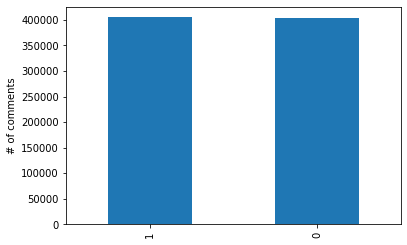

In [ ]:
print(train_data['label'].value_counts())
train_data['label'].value_counts().plot(kind = 'bar')
plt.ylabel("# of comments");

As we can see from the above chart, we have a balaned dataset and we have a fair distribution for the label in our data.

Now, lets see whether the **length distibution** (the length of the comment) of the sarcastic and ordinary comments in the chart below.

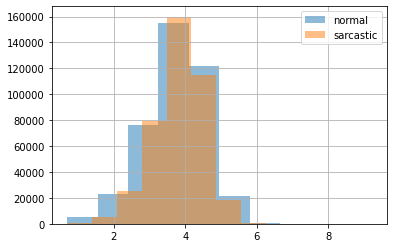

In [ ]:
train_data.loc[train_data['label'] == 0, 'comment'].str.len().apply(np.log1p).hist(label='normal', alpha=.5)
train_data.loc[train_data['label'] == 1, 'comment'].str.len().apply(np.log1p).hist(label='sarcastic', alpha=.5)
plt.legend();

We can see from the above chart that these distributions are almost the same.

Lets see what are the most popular subreddits.

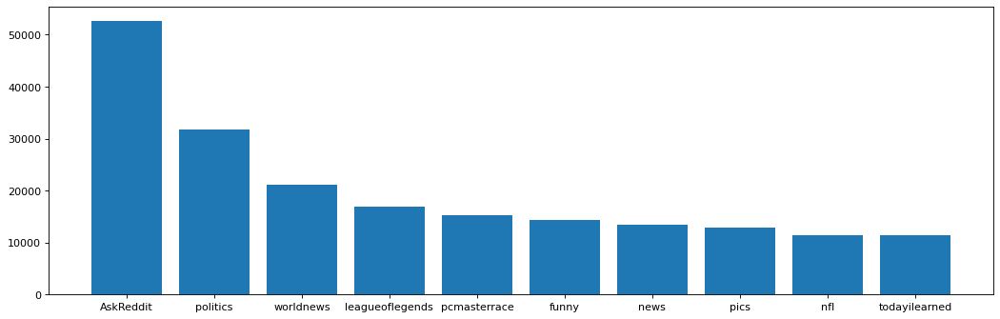

In [ ]:
pop_df = train_data.groupby('subreddit')['label'].agg([np.size])
pop_df = pop_df.sort_values(by='size', ascending=False).head(10)
figure(figsize=(16, 5), dpi=80)
plt.bar(pop_df.index, pop_df['size']);

Here, we see which subreddit is more sarcastic **in average**. We will only consider pupular subreddits. For example, the ones that have more than 1000 comments.

In [ ]:
sub_df = train_data.groupby('subreddit')['label'].agg([np.mean, np.size])
sub_df[sub_df['size'] > 1000].sort_values(by='mean', ascending=False).head(10)

,mean,size
subreddit,,
creepyPMs,0.787263,4381
MensRights,0.678899,2725
ShitRedditSays,0.663842,1062
Conservative,0.645478,1526
atheism,0.643845,5930
worldnews,0.639923,21201
Libertarian,0.637293,2054
facepalm,0.627586,1015
TwoXChromosomes,0.623211,1258


Same as above, lets see which author is more sarcastic **in average**. We will only consider active authors. For example, the ones that have more than 200 comments.

In [ ]:
author_df = train_data.groupby('author')['label'].agg([np.mean, np.size])
author_df[author_df['size'] > 200].sort_values(by='mean', ascending=False).head(5)

,mean,size
author,,
NeonDisease,0.526786,336
Chaoslab,0.514851,202
mindlessrabble,0.514644,239
ivsciguy,0.510638,282
Canada_girl,0.504065,246


Also, it would be intresting to see what score these sarcastic comments usually get. We can categorize these scores to positive and negative scores as follows.

In [ ]:
p_score_df = train_data[train_data['score'] >= 0].groupby('score')['label'].agg([np.size, np.mean])
p_score_df[p_score_df['size'] > 200].sort_values(by='mean', ascending=False).head(10)

,size,mean
score,,
0,46438,0.614303
68,205,0.600000
60,239,0.589958
58,292,0.575342
26,1485,0.558923
59,260,0.557692
20,2485,0.556539
34,843,0.555160
18,3169,0.553487


In [ ]:
p_score_df = train_data[train_data['score'] < 0].groupby('score')['label'].agg([np.size, np.mean])
p_score_df[p_score_df['size'] > 200].sort_values(by='mean', ascending=False).head(10)

,size,mean
score,,
-8,1473,0.701969
-6,2469,0.694208
-14,428,0.686916
-12,626,0.685304
-9,1211,0.684558
-10,940,0.680851
-3,5360,0.676866
-7,1882,0.675877
-16,298,0.674497


Below bar plot shows the number of sarcastic comments per day of the week. As you see, the number of sarcastic comments on Saturday and Sunday is lower than on other days. One of the reasons might be users don’t send comments a lot on the weekend!

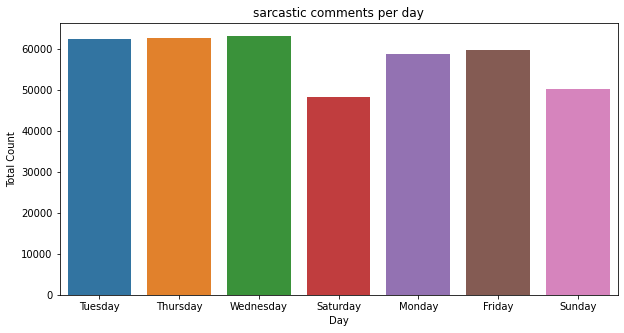

In [ ]:
copy_df = train_data.copy()
copy_df['created_utc'] = pd.to_datetime(copy_df['created_utc'], format = '%Y-%m-%d %H:%M:%S')
copy_df['day'] = copy_df['created_utc'].dt.day_name()

plt.figure(figsize=(10,5))
ax = sns.countplot(x='day',  data= copy_df.loc[copy_df['label']==1])
ax.set(title = "sarcastic comments per day", xlabel="Day", ylabel = "Total Count");

Following count-plot shows that the number of sarcastic comments in the second 6 months of the year is more than the first one.

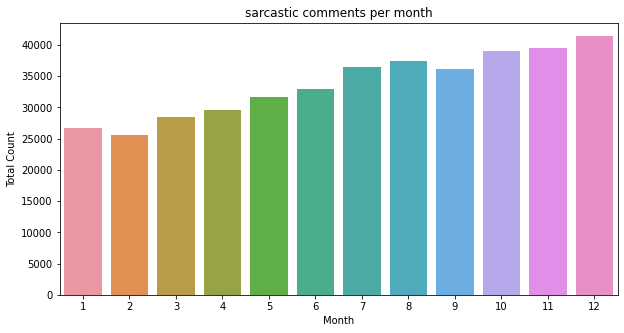

In [ ]:
copy_df['month'] = copy_df['created_utc'].dt.month

plt.figure(figsize=(10,5))
ax = sns.countplot(x='month',  data= copy_df.loc[copy_df['label']==1])
ax.set(title = "sarcastic comments per month", xlabel="Month", ylabel = "Total Count");

In [ ]:
from wordcloud import WordCloud, STOPWORDS

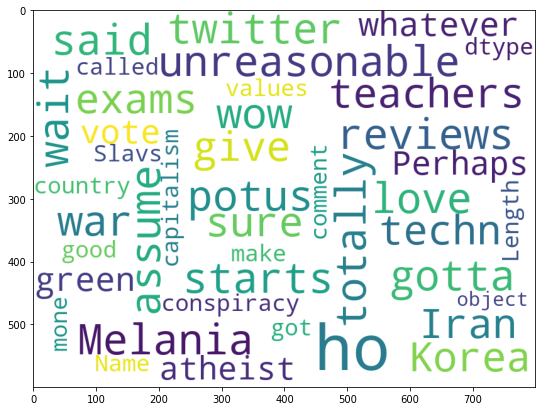

In [ ]:
''' WordClout for sarcastic comments '''

wordcloud = WordCloud(background_color='white', stopwords = STOPWORDS,
                max_words = 200, max_font_size = 100, 
                width=800, height=600)

plt.figure(figsize=(9, 9))
wordcloud.generate(str(train_data.loc[train_data['label'] == 1, 'comment']))
plt.grid(b= False)
plt.imshow(wordcloud);

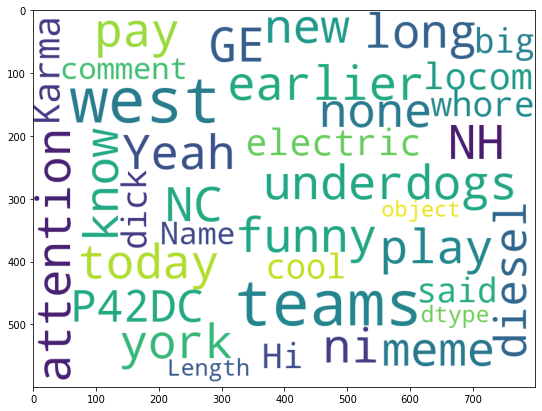

In [ ]:
''' WordClout for non-sarcastic comments '''

wordcloud = WordCloud(background_color='white', stopwords = STOPWORDS,
                max_words = 200, max_font_size = 100, 
                width=800, height=600)

plt.figure(figsize=(9, 9))
wordcloud.generate(str(train_data.loc[train_data['label'] == 0, 'comment']))
plt.grid(b= False)
plt.imshow(wordcloud);

# Feature Engineering and Modeling

In [ ]:
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import f1_score
import eli5
from gensim.models import Word2Vec
from sklearn.pipeline import Pipeline
import texthero as hero
from texthero import preprocessing
from sklearn.decomposition import PCA
from matplotlib import pyplot as plt
import plotly.graph_objects as go
from gensim.models import FastText
from sklearn.svm import SVC
from sklearn.preprocessing import OneHotEncoder
from sklearn.preprocessing import LabelEncoder
from scipy.sparse import hstack
from sklearn.decomposition import TruncatedSVD
from gensim.models.doc2vec import Doc2Vec, TaggedDocument
from sklearn.ensemble import AdaBoostClassifier
from sklearn.naive_bayes import GaussianNB

/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:144: FutureWarning: The sklearn.feature_selection.base module is  deprecated in version 0.22 and will be removed in version 0.24. The corresponding classes / functions should instead be imported from sklearn.feature_selection. Anything that cannot be imported from sklearn.feature_selection is now part of the private API.
  warnings.warn(message, FutureWarning)


## Embeddings

### tf-idf

<div align='justify'>

First of all, we select the comment column and create a Term Frequency–Inverse Document Frequency (tf-idf) matrix. Rows of this matrix are our instances, and columns are terms. Each element of this matrix shows tf-idf weight of the term in a corresponding comment. <br>
The tf-idf is a numerical statistic that reflects how a word is important in a document. To create the tf-idf matrix, it's required to have the count of each word(term) in each doc, and after that, the count of each word in the whole corpus. After gathering these statistics, we use the below formulas to calculate tf-idf for each doc and term. <br>

</div>

<center><img src='https://miro.medium.com/max/367/1*XaDXl8ZCjeapL0_0MmNlnQ.png' alt='Source: R-bloggers, https://www.r-bloggers.com/2014/02/the-tf-idf-statistic-for-keyword-extraction/' align='center'>

<a size=1 href='https://www.r-bloggers.com/2014/02/the-tf-idf-statistic-for-keyword-extraction/'>R-bloggers</a> <br>


In [ ]:
%%time
comment_text = train_data['comment']
tf_idf_train_vectorizer = TfidfVectorizer(stop_words={'english'}, ngram_range=(1, 3), max_features=10000)
tf_idf_comment_text = tf_idf_train_vectorizer.fit_transform(comment_text)

CPU times: user 1min 10s, sys: 3.67 s, total: 1min 14s
Wall time: 1min 14s


After creating tf-idf embedding for each data, splitting data to train set and validation set is necessary to evaluate models.

In [ ]:
''' Splitting data to train and validation '''

tf_idf_train_data, tf_idf_validation_data, tf_idf_train_labels, tf_idf_validation_labels = \
train_test_split(tf_idf_comment_text, train_data['label']) 

In [ ]:
''' Preprocessing test data and create its tf-idf embeddint '''

comment_text = test_data['comment']
tf_idf_test_comment_text = tf_idf_train_vectorizer.fit_transform(comment_text)
tf_idf_test_data = tf_idf_test_comment_text
tf_idf_test_labels = test_data["label"]

In [ ]:
tf_idf_train_data.shape, tf_idf_validation_data.shape, tf_idf_test_data.shape

((606720, 10000), (202240, 10000), (201813, 10000))

#### Visualizing tf-idf embedding

In [ ]:
''' Using truncated SVD to reduce n*10000 sparse matrix to n*2 matrix''' 

X = tf_idf_train_data.T
tSVD = TruncatedSVD(n_components=2)
result = tSVD.fit_transform(X)

# create df from the pca results
pca_df = pd.DataFrame(result, columns = ['x','y'])

# add the words for the hover effect
pca_df['word'] = list(tf_idf_train_vectorizer.vocabulary_.keys())
pca_df.head()

,x,y,word
0,0.048946,-0.004012,could
1,0.243435,0.003224,use
2,0.990559,-0.072394,one
3,0.044299,-0.005931,of
4,0.095303,-0.010397,those


In the below plot, you can see a representation of words on two axes. The tf-idf matrix contains only the frequency of terms, neither semantical nor synthetical meaning of terms. So we can say the below plot has no helpful information about the semantical similarity of terms. In other words, the neighbor terms have no similar or related meaning; unlike other embeddings like Word2Vec.

In [ ]:
N = 1000000
words = list(tf_idf_train_vectorizer.vocabulary_)
fig = go.Figure(data=go.Scattergl(
    x = pca_df['x'],
    y = pca_df['y'],
    mode='markers',
    marker=dict(
        color=np.random.randn(N),
        colorscale='Viridis',
        line_width=1
    ),
    text=pca_df['word'],
    textposition="bottom center"
))
fig.show()

#### Modeling with tf-idf

##### Logistic Regression

In [ ]:
''' Logistic Regression on comment tf-idf embedding '''
lr = LogisticRegression(n_jobs=-1, solver='saga')
lr.fit(tf_idf_train_data, tf_idf_train_labels)
tf_idf_validation_predicted_labels = lr.predict(tf_idf_validation_data)
print('f1-score of logistic regression with tf-idf on validataion data is :', \
      f1_score(tf_idf_validation_labels, tf_idf_validation_predicted_labels))

f1-score of logistic regression with tf-idf on validataion data is : 0.6919942362219365


In [ ]:
tf_idf_test_predicted_labels = lr.predict(tf_idf_test_data)
print('f1-score of logistic regression with tf-idf on test data is :', \
      f1_score(tf_idf_test_labels, tf_idf_test_predicted_labels))

f1-score of logistic regression with tf-idf on test data is : 0.5105072893514102


In [ ]:
evluate_model(lr,
        {'train_data':tf_idf_train_data,
         'train_labels':tf_idf_train_labels,
         'val_data':tf_idf_validation_data,
         'val_labels':tf_idf_validation_labels,
         'test_data':tf_idf_test_data,
         'test_labels':tf_idf_test_labels
        }
)

,train,validation,test
accuracy,0.717913,0.705118,0.529669
f1,0.705334,0.691994,0.510507
precision,0.739051,0.723881,0.530628
recall,0.674559,0.662798,0.491857
f1_negative,0.729462,0.717169,0.547386
precision_negative,0.700136,0.689287,0.528844
recall_negative,0.761352,0.747400,0.567276
roc_auc,0.717955,0.705099,0.529566
average_precision_score,0.661414,0.648314,0.514376


The below data frame shows the weight and effect of each term (and bigram) on being a sarcastic sentence. 

In [ ]:
eli5.show_weights(estimator=lr, vec=tf_idf_train_vectorizer, top=40)

Weight?,Feature
+7.762,yep
+6.208,obviously the
+5.982,clip
+5.846,yea because
+5.217,too long
+5.197,dont think
+5.070,get all
+4.720,because don
+4.689,gosh
+4.604,rice


##### AdaBoost

In [ ]:
%%time

base = LogisticRegression(n_jobs=-1, solver='saga')
# define ensemble model
ada = AdaBoostClassifier(base_estimator=base)
ada.fit(tf_idf_train_data, tf_idf_train_labels)
tf_idf_validation_predicted_labels = ada.predict(tf_idf_validation_data)
print('f1-score of ADA-Boost with tf-idf is :', \
      f1_score(tf_idf_validation_labels, tf_idf_validation_predicted_labels))

f1-score of ADA-Boost with tf-idf is : 0.641463106575391


In [ ]:
tf_idf_test_predicted_labels = ada.predict(tf_idf_test_data)
print('f1-score of ADA-Boost with tf-idf for test data is :', \
      f1_score(tf_idf_test_labels, tf_idf_test_predicted_labels))

f1-score of ADA-Boost with tf-idf for test data is : 0.4011868205905598


In [ ]:
evluate_model(ada,
        {'train_data':tf_idf_train_data,
         'train_labels':tf_idf_train_labels,
         'val_data':tf_idf_validation_data,
         'val_labels':tf_idf_validation_labels,
         'test_data':tf_idf_test_data,
         'test_labels':tf_idf_test_labels
        }
)

,train,validation,test
accuracy,0.650702,0.649095,0.541982
f1,0.642768,0.641463,0.401187
precision,0.658387,0.655427,0.576300
recall,0.627872,0.628082,0.307692
f1_negative,0.658292,0.656409,0.629172
precision_negative,0.643685,0.643275,0.529531
recall_negative,0.673577,0.670090,0.775005
roc_auc,0.650725,0.649086,0.541349
average_precision_score,0.599630,0.597540,0.522539


#### Adding Other Features to tf-idf embedding to improve models

<div align='justify'>

For improving the logistic regression model, we can add the subreddit and the date column to our training dataset, which contains the only comment. For this, we must convert these two columns to a computer-readable format. So we can embed the subreddit column with tf-idf and encode the date column with one-hot method. Also, considering the number of unique scores, we can create one-hot encodes of the score column and add them to the new dataset.

</div>

In [ ]:
# Preparing Train Data

%%time
temp_data = train_data[['comment', 'subreddit', 'date', 'score']]

tf_idf_comment_vectorizer = TfidfVectorizer(stop_words={'english'}, ngram_range=(1, 2), max_features=5000)
tf_idf_comment_text = tf_idf_comment_vectorizer.fit_transform(temp_data['comment'])

tf_idf_subreddit_vectorizer = TfidfVectorizer()
tf_idf_subreddit_text = tf_idf_subreddit_vectorizer.fit_transform(temp_data['subreddit'])

one_hot_encoder = OneHotEncoder()
date_one_hot_matrix = one_hot_encoder.fit_transform(pd.DataFrame(temp_data['date'])) 
score_one_hot_matrix = one_hot_encoder.fit_transform(pd.DataFrame(temp_data['score']))

temp_matrix = hstack([
                      tf_idf_comment_text,
                      tf_idf_subreddit_text,
                      date_one_hot_matrix,
                      score_one_hot_matrix,
])
tf_idf_train_data, tf_idf_validation_data, tf_idf_train_labels, tf_idf_validation_labels = \
train_test_split(temp_matrix, train_data['label']) 

CPU times: user 40.2 s, sys: 513 ms, total: 40.7 s
Wall time: 40.6 s


In [ ]:
tf_idf_train_data.shape, tf_idf_validation_data.shape

((606720, 19896), (202240, 19896))

In [ ]:
%%time
lr = LogisticRegression(n_jobs=-1, solver='saga')
lr.fit(tf_idf_train_data, tf_idf_train_labels)
tf_idf_validation_predicted_labels = lr.predict(tf_idf_validation_data)
print('f1-score of logistic regression with tf-idf on validataion data is :', \
      f1_score(tf_idf_validation_labels, tf_idf_validation_predicted_labels))

f1-score of logistic regression with tf-idf on validataion data is : 0.6971549928695278
CPU times: user 13.5 s, sys: 19.1 ms, total: 13.5 s
Wall time: 13.5 s


In [ ]:
evluate_model(lr,
        {'train_data':tf_idf_train_data,
         'train_labels':tf_idf_train_labels,
         'val_data':tf_idf_validation_data,
         'val_labels':tf_idf_validation_labels,
         'test_data':None,
         'test_labels':None
        }
)

,train,validation,test
accuracy,0.718676,0.708089,None
f1,0.708937,0.697155,None
precision,0.734884,0.724695,None
recall,0.684760,0.671632,None
f1_negative,0.727784,0.718262,None
precision_negative,0.704520,0.693736,None
recall_negative,0.752637,0.744585,None
roc_auc,0.718698,0.708109,None
average_precision_score,0.660944,0.650998,None


The F1-score of logistic regression with an improved dataset is slightly better than the previous logistic regression model.

### word2vec

<div align='justify'>

Word2Vec is an embedding technique that uses a neural network model to learn word associations from a large corpus of docs. Once the Word2Vec model is trained, it can detect synonymous words and phrases. With this model, we can embed high-dimensional text docs into numerical vectors. <br>
Word2vec can utilize either of two model architectures to produce a distributed representation of words: continuous bag-of-words (CBOW) or continuous skip-gram. In the continuous bag-of-words architecture, the model predicts the current word from a window of surrounding context words. In the continuous skip-gram architecture, the model uses the current word to predict the surrounding window of context words. 

<img src='https://www.researchgate.net/profile/Metin-Bilgin/publication/320829283/figure/fig2/AS:759096500318213@1557994117366/Word2Vec-CBOW-and-Skip-gram-There-are-two-different-methods-in-the-Word2Vec-algorithm.png'>

</div>

For creating Word2Vec embedding for comment column in train_data dataset, we need to clean and tokenize words of comments. For this, we use pipeline and texthero.preprocessing for applying fillna, lowercase, remove the stopwords and punctuatoins, and tokenize the comments. Resluts is saved in clean_comment column in  comment_text_df. After that we create our word2vec model and train it with clean_comments.

In [ ]:
# Building custom piplines, cleaning and tokenizing comment texts, building Word2Vec Models

%%time

custom_pipeline = [preprocessing.fillna,
                   preprocessing.lowercase,
                   preprocessing.remove_stopwords,       #### need to revise
                   preprocessing.remove_punctuation,
                   preprocessing.remove_digits,
                   preprocessing.tokenize,
                  ]

comment_train_text_df = pd.DataFrame(train_data['comment'])
comment_train_text_df['clean_comment'] = hero.clean(comment_train_text_df['comment'], custom_pipeline)
word2vec_train_model = Word2Vec(sentences=comment_train_text_df['clean_comment'], window=7, workers=4, iter=10, size=200)

comment_test_text_df = pd.DataFrame(test_data['comment'])
comment_test_text_df['clean_comment'] = hero.clean(comment_test_text_df['comment'], custom_pipeline)

CPU times: user 3min 48s, sys: 979 ms, total: 3min 49s
Wall time: 2min 17s


In [ ]:
print(len(word2vec_train_model.wv.vocab))
# print(len(word2vec_test_model.wv.vocab))

37065


#### Visualizing Word2Vec

In [ ]:
X = word2vec_train_model[word2vec_train_model.wv.vocab]
pca = PCA(n_components=2)
result = pca.fit_transform(X)

# create df from the pca results
pca_df = pd.DataFrame(result, columns = ['x','y'])

# add the words for the hover effect
pca_df['word'] = list(word2vec_train_model.wv.vocab.keys())
pca_df.head()

Unlike the tf-idf scatter plot, terms with similar meanings are near to each other in this embedding. **For example, in the left top side of the below scatter plot, terms like 'ram', 'cpu', 'gpu', 'screen', 'fps' and … are in the same neighborhood. **

In [ ]:
N = 1000000
words = list(word2vec_train_model.wv.vocab)
fig = go.Figure(data=go.Scattergl(
    x = pca_df['x'],
    y = pca_df['y'],
    mode='markers',
    marker=dict(
        color=np.random.randn(N),
        colorscale='Viridis',
        line_width=1
    ),
    text=pca_df['word'],
    textposition="bottom center"
))
fig.show()

#### Creating word2vec embedding for each comment

To classify the comments sarcastic and non-sarcastic, we need to build a feature vector for each comment. Our simple way is just component-wisely averaging the embedding vectors for each word in the comment. The resulting vector would be our feature representation for that comment, and now we can use it as input to build our classifier.

In [ ]:
%%time
def __filter_w2vs(model, vecs):
    return [model.wv[j] for j in vecs if j in model.wv]

comment_train_text_df['word2vec'] = comment_train_text_df['clean_comment'].apply(
    lambda i: sum(__filter_w2vs(word2vec_train_model, i)) / len(__filter_w2vs(word2vec_train_model, i)) \
     if (__filter_w2vs(word2vec_train_model, i)) else np.NaN
    )

comment_test_text_df['word2vec'] = comment_test_text_df['clean_comment'].apply(
    lambda i: sum(__filter_w2vs(word2vec_train_model, i)) / len(__filter_w2vs(word2vec_train_model, i)) \
     if (__filter_w2vs(word2vec_train_model, i)) else np.NaN
    )

CPU times: user 39.4 s, sys: 118 ms, total: 39.5 s
Wall time: 39.5 s


In [ ]:
# train validation test splitting 
w2v_train_data, w2v_validation_data, w2v_train_label, w2v_validation_label = \
train_test_split(comment_train_text_df['word2vec'], train_data['label']) 
w2v_test_data = comment_test_text_df['word2vec']
w2v_test_label = test_data['label']

w2v_train_data.shape, w2v_validation_data.shape, w2v_test_data.shape

((606720,), (202240,), (201813,))

In [ ]:
# extracting each comment's list and converting each element of list to a column
w2v_train_data = pd.DataFrame.from_dict(dict(zip(w2v_train_data.index, w2v_train_data.values)))
w2v_train_data = w2v_train_data.T
w2v_validation_data = pd.DataFrame.from_dict(dict(zip(w2v_validation_data.index, w2v_validation_data.values)))
w2v_validation_data = w2v_validation_data.T
w2v_test_data = pd.DataFrame.from_dict(dict(zip(w2v_test_data.index, w2v_test_data.values)))
w2v_test_data = w2v_test_data.T

In [ ]:
# applying some little changes on datasets
w2v_train_data = w2v_train_data.dropna()
w2v_train_label = w2v_train_label.loc[w2v_train_data.index]
w2v_validation_data = w2v_validation_data.dropna()
w2v_validation_label = w2v_validation_label.loc[w2v_validation_data.index]
w2v_test_data = w2v_test_data.dropna()
w2v_test_label = w2v_test_label.loc[w2v_test_data.index]

In [ ]:
w2v_train_data.shape, w2v_train_label.shape

((593934, 200), (593934,))

#### Logistic Regression with word2vec embedding

In [ ]:
%%time
lr = LogisticRegression(n_jobs=-1, solver='sag')
lr.fit(w2v_train_data, w2v_train_label)
w2v_validation_predicted_label = lr.predict(w2v_validation_data)
print('f1-score of logistic regression with word2vec on validation data is :', \
      f1_score(w2v_validation_label, w2v_validation_predicted_label))

f1-score of logistic regression with word2vec on validation data is : 0.6366895059127113
CPU times: user 41.1 s, sys: 145 ms, total: 41.3 s
Wall time: 41 s


In [ ]:
w2v_test_predicted_label = lr.predict(w2v_test_data)
print('f1-score of logistic regression with word2vec for test data is :', \
      f1_score(w2v_test_label, w2v_test_predicted_label))

f1-score of logistic regression with word2vec for test data is : 0.6353839573531407


The F1-score on test data is not good. Because our model tends to predict 0 more than 1. In other words, the recall of the model is low. So this model with this embedding is not a candidate for the final model.

In [ ]:
eli5.show_weights(estimator=lr, vec=word2vec_train_model)

Weight?,Feature
+0.330,x102
+0.314,x186
+0.298,x148
+0.251,x161
+0.247,x19
+0.245,x41
+0.240,x127
+0.236,x52
+0.234,x68
+0.223,x35


In [ ]:
evluate_model(lr,
        {'train_data':w2v_train_data,
         'train_labels':w2v_train_label,
         'val_data':w2v_validation_data,
         'val_labels':w2v_validation_label,
         'test_data':w2v_test_data,
         'test_labels':w2v_test_label
        }
)

,train,validation,test
accuracy,0.647995,0.647256,0.645937
f1,0.637947,0.636690,0.635384
precision,0.664548,0.664213,0.660758
recall,0.613395,0.611356,0.611887
f1_negative,0.657499,0.657226,0.655896
precision_negative,0.633511,0.632498,0.632957
recall_negative,0.683376,0.683966,0.680560
roc_auc,0.648385,0.647661,0.646223
average_precision_score,0.603091,0.602559,0.599985


#### GaussianNB with word2vec embedding

In [ ]:
nb = GaussianNB(var_smoothing=1e-3)
nb.fit(w2v_train_data, w2v_train_label)
w2v_validation_predicted_label = nb.predict(w2v_validation_data)
print('f1-score of Gaussian Naive Bayes with word2vec is :', \
      f1_score(w2v_validation_label, w2v_validation_predicted_label))

f1-score of Gaussian Naive Bayes with word2vec is : 0.6098249917069591


In [ ]:
w2v_test_predicted_label = nb.predict(w2v_test_data)
print('f1-score of Gaussian Naive Bayes with word2vec for test data is :', \
      f1_score(w2v_test_label, w2v_test_predicted_label))

f1-score of Gaussian Naive Bayes with word2vec for test data is : 0.6076312875712242


One reason for using Gaussian Naive Bayes instead of more complex models like AdaBoost and SVM is performance. Training Naive Bayes is far faster than AdaBoost and SVM (5 seconds vs 30 minutes and 4 hours!). Also, the accuracy of Naive Bayes on this DataSet with Word2Vec is far better than those two models.

In [ ]:
evluate_model(nb,
        {'train_data':w2v_train_data,
         'train_labels':w2v_train_label,
         'val_data':w2v_validation_data,
         'val_labels':w2v_validation_label,
         'test_data':w2v_test_data,
         'test_labels':w2v_test_label
        }
)

,train,validation,test
accuracy,0.608027,0.607872,0.606910
f1,0.610011,0.609825,0.607631
precision,0.613723,0.613575,0.611605
recall,0.606345,0.606121,0.603709
f1_negative,0.606023,0.605899,0.606186
precision_negative,0.602343,0.602182,0.602259
recall_negative,0.609748,0.609663,0.610164
roc_auc,0.608046,0.607892,0.606937
average_precision_score,0.571153,0.571036,0.569031


The results for this model with word2vec are slightly better than logistic regression. But still isn't good enough to be the final model.  

#### Adding Other Features to Word2Vec embedding to improve models

Like tf-idf section, we add other columns to the dataset to improve our model generalization. But in this section, instead of adding tf-idf embedding of the subreddit column, we add one-hot encoding of this column. 

In [ ]:
one_hot_encoder = OneHotEncoder()

temp = comment_train_text_df.copy()
temp = temp.dropna()
word2vec_matrix = np.stack(temp['word2vec'].values)

temp_dataset = train_data[['label', 'subreddit', 'date', 'score']]
temp_dataset = temp_dataset.loc[temp.index]
temp_dataset = temp_dataset.dropna()
temp_dataset_label = temp_dataset['label']
temp_dataset = temp_dataset.drop(columns=['label'])
temp_dataset_matrix = hstack([
    word2vec_matrix,
    one_hot_encoder.fit_transform(temp_dataset[['subreddit', 'date', 'score']])
])

temp_dataset_matrix

<791905x14902 sparse matrix of type '<class 'numpy.float64'>'
	with 160756713 stored elements in COOrdinate format>

In [ ]:
temp_w2v_train_data, temp_w2v_validation_data, temp_w2v_train_label, temp_w2v_validation_label = \
train_test_split(temp_dataset_matrix, temp_dataset_label) 

In [ ]:
temp_w2v_train_data, temp_w2v_validation_data

(<593928x14902 sparse matrix of type '<class 'numpy.float64'>'
 	with 120567382 stored elements in Compressed Sparse Row format>,
 <197977x14902 sparse matrix of type '<class 'numpy.float64'>'
 	with 40189331 stored elements in Compressed Sparse Row format>)

In [ ]:
%%time
lr = LogisticRegression(n_jobs=-1, solver='saga')
lr.fit(temp_w2v_train_data, temp_w2v_train_label)
temp_w2v_validation_predicted_label = lr.predict(temp_w2v_validation_data)
print('f1-score of logistic regression with word2vec on validation data is :', \
      f1_score(temp_w2v_validation_label, temp_w2v_validation_predicted_label))

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_sag.py:330: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge



f1-score of logistic regression with word2vec on validation data is : 0.6625730994152047
CPU times: user 3min 24s, sys: 208 ms, total: 3min 24s
Wall time: 3min 23s


The F1-score of logistic regression with an improved dataset is slightly better than the previous logistic regression model. (~ +0.03)

In [ ]:
evluate_model(lr,
        {'train_data':temp_w2v_train_data,
         'train_labels':temp_w2v_train_label,
         'val_data':temp_w2v_validation_data,
         'val_labels':temp_w2v_validation_label,
         'test_data':None,
         'test_labels':None
        }
)

,train,validation,test
accuracy,0.668800,0.661920,None
f1,0.667984,0.662573,None
precision,0.676591,0.670613,None
recall,0.659593,0.654724,None
f1_negative,0.669612,0.661265,None
precision_negative,0.661241,0.653401,None
recall_negative,0.678197,0.669320,None
roc_auc,0.668895,0.662022,None
average_precision_score,0.618220,0.614112,None


### FastText

<div align='justify'>

FastText is an embedding technique that uses a neural network with only one layer. Below is the architecture of FastText:

<img src='https://miro.medium.com/max/3000/1*AgrrRZ9DpUVb3srTWs0gzA.png' width="400">

The bag-of-words representation of the text is first fed into a lookup layer, where the embeddings are fetched for every single word. Then, those word embeddings are averaged, so as to obtain a single averaged embedding for the whole text. At the hidden layer there are <b>n_words x dim</b> number of parameters, where <b>dim</b> is the size of the embeddings and n_words is the vocabulary size. After the averaging, there is only one single vector which is then fed to a linear classifier: we apply the softmax over a linear transformation of the output of the input layer. The linear transformation is a matrix with <b>dim x n_output</b>, where <b>n_output</b> is the number output classes. 

All in all the final log-likelihood is:<br>
<img src='https://miro.medium.com/max/273/1*gBf6hJWibfiwHDdUbiQusw.png'> <br>
where

1) <b>x_n</b> is the original one-hot-encoded representation of a word (or n-gram feature).<br>
2) A is the look_up matrix that retrieves the word embedding.<br>
3) B is the linear output transformation.<br>
4) f is the softmax function

some advantages of this embedding technique are:<br>
1) Fast training process <br>
2) High performance <br>
3) Word embeddigs generated by FastText are better than word2vec embeddings because FastText Enriching Word Vectors with Subword Information. Therefore, FastText is more robust to misspellings.

</div>

In [ ]:
%%time
custom_pipeline = [preprocessing.fillna,
                   preprocessing.lowercase,
                   preprocessing.remove_stopwords,       #### need to revise
                   preprocessing.remove_punctuation,
                   preprocessing.remove_digits,
                   preprocessing.tokenize,
                  ]

comment_train_text_df = pd.DataFrame(train_data['comment'])
comment_train_text_df['clean_comment'] = hero.clean(comment_train_text_df['comment'], custom_pipeline)
fasttext_train_model = FastText(sentences=comment_train_text_df['clean_comment'], window=7, workers=4, iter=10, size=200)


comment_test_text_df = pd.DataFrame(test_data['comment'])
comment_test_text_df['clean_comment'] = hero.clean(comment_test_text_df['comment'], custom_pipeline)

CPU times: user 12min 52s, sys: 4.13 s, total: 12min 56s
Wall time: 6min 59s


#### Visualizing FastText embedding

In [ ]:
X = fasttext_train_model[fasttext_train_model.wv.vocab]
pca = PCA(n_components=2)
result = pca.fit_transform(X)

# create df from the pca results
pca_df = pd.DataFrame(result, columns = ['x','y'])

# add the words for the hover effect
pca_df['word'] = list(fasttext_train_model.wv.vocab.keys())
pca_df.head()

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: DeprecationWarning:

Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).



,x,y,word
0,2.176467,-1.198665,nc
1,2.828862,-1.221376,nh
2,-0.940969,-2.359212,know
3,-0.353375,-3.463974,west
4,-0.215146,2.886689,teams


Scatter plot for FastText embedded words is similar to word2vec plot but there is fewer word similarity between neighbor words in below plot. So we can say that Word2Vec Embedding emphasizes word meanings more than FastText embedding.

In [ ]:
# N = 1000000
# words = list(fasttext_train_model.wv.vocab)
# fig = go.Figure(data=go.Scattergl(
#     x = pca_df['x'],
#     y = pca_df['y'],
#     mode='markers',
#     marker=dict(
#         color=np.random.randn(N),
#         colorscale='Viridis',
#         line_width=1
#     ),
#     text=pca_df['word'],
#     textposition="bottom center"
# ))
# fig.show()

#### Creating FastText embedding for each comment

In [ ]:
%%time
def __filter_w2vs(model, vecs):
    return [model.wv[j] for j in vecs if j in model.wv]

comment_train_text_df['fasttext'] = comment_train_text_df['clean_comment'].apply(
    lambda i: sum(__filter_w2vs(fasttext_train_model, i)) / len(__filter_w2vs(fasttext_train_model, i)) \
     if (__filter_w2vs(fasttext_train_model, i)) else np.NaN
    )

comment_test_text_df['fasttext'] = comment_test_text_df['clean_comment'].apply(
    lambda i: sum(__filter_w2vs(fasttext_train_model, i)) / len(__filter_w2vs(fasttext_train_model, i)) \
     if (__filter_w2vs(fasttext_train_model, i)) else np.NaN
    )

CPU times: user 1min 29s, sys: 591 ms, total: 1min 30s
Wall time: 1min 30s


In [ ]:
fasttext_train_data, fasttext_validation_data, fasttext_train_label, fasttext_validation_label = \
train_test_split(comment_train_text_df['fasttext'], train_data['label'])

fasttext_test_data = comment_test_text_df['fasttext']
fasttext_test_label = test_data['label']

fasttext_train_data.shape, fasttext_validation_data.shape, fasttext_test_data.shape

((606720,), (202240,), (201813,))

In [ ]:
# extracting each comment's list and converting each element of list to a column
fasttext_train_data = pd.DataFrame.from_dict(dict(zip(fasttext_train_data.index, fasttext_train_data.values)))
fasttext_train_data = fasttext_train_data.T

fasttext_validation_data = pd.DataFrame.from_dict(dict(zip(fasttext_validation_data.index, fasttext_validation_data.values)))
fasttext_validation_data = fasttext_validation_data.T

fasttext_test_data = pd.DataFrame.from_dict(dict(zip(fasttext_test_data.index, fasttext_test_data.values)))
fasttext_test_data = fasttext_test_data.T

In [ ]:
fasttext_train_data = fasttext_train_data.dropna()
fasttext_train_label = fasttext_train_label.loc[fasttext_train_data.index]
fasttext_validation_data = fasttext_validation_data.dropna()
fasttext_validation_label = fasttext_validation_label.loc[fasttext_validation_data.index]
fasttext_test_data = fasttext_test_data.dropna()
fasttext_test_label = fasttext_test_label.loc[fasttext_test_data.index]

#### Logistic Regression with FastText embedding

In [ ]:
%%time
lr = LogisticRegression(n_jobs=-1, solver='sag', class_weight='balanced')
lr.fit(fasttext_train_data, fasttext_train_label)
fasttext_validation_predicted_label = lr.predict(fasttext_validation_data)
print('f1-score of logistic regression with FastText is :', \
      f1_score(fasttext_validation_label, fasttext_validation_predicted_label))

f1-score of logistic regression with FastText is : 0.6273971613276029
CPU times: user 35.2 s, sys: 153 ms, total: 35.3 s
Wall time: 35.1 s


In [ ]:
fasttext_test_predicted_label = lr.predict(fasttext_test_data)
print('f1-score of logistic regression with FastText for test data is :', \
      f1_score(fasttext_test_label, fasttext_test_predicted_label))

f1-score of logistic regression with FastText for test data is : 0.6247019403101379


In [ ]:
eli5.show_weights(estimator=lr, vec=fasttext_train_model)

In [ ]:
evluate_model(lr,
        {'train_data':fasttext_train_data,
         'train_labels':fasttext_train_label,
         'val_data':fasttext_validation_data,
         'val_labels':fasttext_validation_label,
         'test_data':fasttext_test_data,
         'test_labels':fasttext_test_label
        }
)

,train,validation,test
accuracy,0.639748,0.638956,0.638087
f1,0.626692,0.627397,0.624702
precision,0.654395,0.654799,0.651208
recall,0.601239,0.602197,0.600270
f1_negative,0.651922,0.649818,0.650549
precision_negative,0.627167,0.625229,0.626794
recall_negative,0.678713,0.676422,0.676176
roc_auc,0.639976,0.639309,0.638223
average_precision_score,0.594000,0.595115,0.591482


As you can see, the results for this model with FastText embedding are terrible! So we should use another model to increase f1 and accuracy on test data.

#### Gaussian Naive Bayes with FastText embedding

In [ ]:
%%time
nb = GaussianNB(var_smoothing=1e-4)      
nb.fit(fasttext_train_data, fasttext_train_label)
fasttext_validation_predicted_label = nb.predict(fasttext_validation_data)
print('f1-score of Naive Bayes with FastText is :', \
      f1_score(fasttext_validation_label, fasttext_validation_predicted_label))

f1-score of Naive Bayes with FastText is : 0.6187828828253137
CPU times: user 2.17 s, sys: 36 ms, total: 2.21 s
Wall time: 2.2 s


In [ ]:
fasttext_test_predicted_label = nb.predict(fasttext_test_data)
print('f1-score of Naive Bayes with FastText for test data is :', \
      f1_score(fasttext_test_label, fasttext_test_predicted_label))

f1-score of Naive Bayes with FastText for test data is : 0.6185541415723892


In [ ]:
evluate_model(nb,
        {'train_data':fasttext_train_data,
         'train_labels':fasttext_train_label,
         'val_data':fasttext_validation_data,
         'val_labels':fasttext_validation_label,
         'test_data':fasttext_test_data,
         'test_labels':fasttext_test_label
        }
)

,train,validation,test
accuracy,0.554610,0.552638,0.553573
f1,0.619284,0.618783,0.618554
precision,0.543144,0.542918,0.541408
recall,0.720252,0.719294,0.721340
f1_negative,0.463466,0.458720,0.461907
precision_negative,0.577569,0.572261,0.578114
recall_negative,0.387009,0.382774,0.384599
roc_auc,0.553630,0.551034,0.552969
average_precision_score,0.531897,0.532208,0.530369


As you see, the f1-score and accuracy of the model increased but aren't good enough to be chosen for the final model.

#### Adding Other Features to FastText embedding to improve models

Like tf-idf and Word2Vec, we add other columns to the dataset to improve our model generalization and performance. Like Word2Vec we add subreddit, date, and score column to fasttext embedding for each comment and use Logistic Regression to train the data.

In [ ]:
one_hot_encoder = OneHotEncoder()

temp = comment_train_text_df.copy()
temp = temp.dropna()
fasttext_matrix = np.stack(temp['fasttext'].values)

temp_dataset = train_data[['label', 'subreddit', 'date', 'score']]
temp_dataset = temp_dataset.loc[temp.index]
temp_dataset = temp_dataset.dropna()
temp_dataset_label = temp_dataset['label']
temp_dataset = temp_dataset.drop(columns=['label'])
temp_dataset_matrix = hstack([
    fasttext_matrix,
    one_hot_encoder.fit_transform(temp_dataset[['subreddit', 'date', 'score']])
])

temp_dataset_matrix

<800250x14993 sparse matrix of type '<class 'numpy.float64'>'
	with 162450748 stored elements in COOrdinate format>

In [ ]:
temp_fasttext_train_data, temp_fasttext_validation_data, temp_fasttext_train_label, temp_fasttext_validation_label = \
train_test_split(temp_dataset_matrix, temp_dataset_label) 

In [ ]:
temp_fasttext_train_data, temp_fasttext_validation_data

(<600187x14993 sparse matrix of type '<class 'numpy.float64'>'
 	with 121837959 stored elements in Compressed Sparse Row format>,
 <200063x14993 sparse matrix of type '<class 'numpy.float64'>'
 	with 40612789 stored elements in Compressed Sparse Row format>)

In [ ]:
%%time
lr = LogisticRegression(n_jobs=-1, solver='sag', class_weight='balanced')
lr.fit(temp_fasttext_train_data, temp_fasttext_train_label)
temp_fasttext_validation_predicted_label = lr.predict(temp_fasttext_validation_data)
print('f1-score of logistic regression with fasttext on validation data is :', \
      f1_score(temp_fasttext_validation_label, temp_fasttext_validation_predicted_label))

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_sag.py:330: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge



f1-score of logistic regression with fasttext on validation data is : 0.6517231575313255
CPU times: user 3min 7s, sys: 186 ms, total: 3min 7s
Wall time: 3min 6s


The F1-score of logistic regression with an improved dataset is slightly better than the previous logistic regression model. (~ +0.03)

In [ ]:
evluate_model(lr,
        {'train_data':temp_fasttext_train_data,
         'train_labels':temp_fasttext_train_label,
         'val_data':temp_fasttext_validation_data,
         'val_labels':temp_fasttext_validation_label,
         'test_data':None,
         'test_labels':None
        }
)

,train,validation,test
accuracy,0.661289,0.657118,None
f1,0.656383,0.651723,None
precision,0.670903,0.666262,None
recall,0.642478,0.637805,None
f1_negative,0.666057,0.662348,None
precision_negative,0.652336,0.648626,None
recall_negative,0.680367,0.676663,None
roc_auc,0.661423,0.657234,None
average_precision_score,0.611063,0.607128,None


## RNN with pre-trained embedding

** **For better performance, restart the notebook and use GPU!** **

In this part, we will use pre-trained word embedding to prepare our text data for training and testing a neural network with an LSTM layer.

### Importing Libraries

In [ ]:
# %reset

In [ ]:
from keras.preprocessing.text import Tokenizer
from keras.preprocessing.sequence import pad_sequences
from keras.layers import Dense, Input, LSTM, Embedding, Dropout, Activation, Flatten, Bidirectional, GlobalMaxPool1D, BatchNormalization
from keras.models import Model
from tqdm.notebook import tqdm
from sklearn.pipeline import Pipeline
from texthero import preprocessing
import texthero as hero
import json
import os
import zipfile
from sklearn.metrics import f1_score
from sklearn.model_selection import train_test_split
import pandas as pd
import numpy as np
from tensorflow.keras import layers
from tensorflow.keras import activations
import tensorflow.keras as keras
import keras.backend as K
from IPython.display import clear_output

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


### Downloading pre-trained Embedder

** **Download only one of the embeddings** ** <br>

There are many pre-trained Embedders, but we tried two of them. 
<ul> <li> First, we tried fasttext-crawl-300d-2m Embedder, which contains 2 million word vectors trained on Common Crawl (600B tokens).  </li>
<li>After that, we use glove-840b-300d, which contains 2.2M million word vectors trained on Common Crawl (840B tokens). </li> </ul>
The latter Embedder has a slight improvement in the performance of the model.

#### version fasttext-crawl-300d-2m

In [ ]:
api_token = {"username":"alibalapour","key":"a206cc6a9ee8fe43949f4c646c0fdaa2"}

try:
    os.makedirs('/root/.kaggle')
except:
    pass

with open('/root/.kaggle/kaggle.json', 'w') as file:
    json.dump(api_token, file)
if not os.path.exists("/content/fasttext-crawl-300d-2m"):
    os.makedirs("/content/fasttext-crawl-300d-2m")
os.chdir('/content/fasttext-crawl-300d-2m')
!kaggle datasets download -d yekenot/fasttext-crawl-300d-2m

os.chdir('/content/fasttext-crawl-300d-2m')
for file in os.listdir():
    try:
        zip_ref = zipfile.ZipFile(file, 'r')
        zip_ref.extractall()
        zip_ref.close()
    except:
        pass

EMBEDDING_FILE = '/content/fasttext-crawl-300d-2m/crawl-300d-2M.vec'

100% 1.44G/1.44G [00:34<00:00, 46.2MB/s]
100% 1.44G/1.44G [00:34<00:00, 45.2MB/s]


#### version glove-840b-300d

In [ ]:
api_token = {"username":"alibalapour","key":"a206cc6a9ee8fe43949f4c646c0fdaa2"}

try:
    os.makedirs('/root/.kaggle')
except:
    pass

with open('/root/.kaggle/kaggle.json', 'w') as file:
    json.dump(api_token, file)
if not os.path.exists("/content/glove-840b-300d"):
    os.makedirs("/content/glove-840b-300d")
os.chdir('/content/glove-840b-300d')
!kaggle datasets download -d takuok/glove840b300dtxt

os.chdir('/content/glove-840b-300d')
for file in os.listdir():
    try:
        zip_ref = zipfile.ZipFile(file, 'r')
        zip_ref.extractall()
        zip_ref.close()
    except:
        pass

EMBEDDING_FILE = '/content/glove-840b-300d/glove.840B.300d.txt'

100% 2.07G/2.08G [00:28<00:00, 59.2MB/s]
100% 2.08G/2.08G [00:28<00:00, 78.0MB/s]


### Cleaning and Tokenizing Comments

In this section, like the previous one, the text data must be cleaned and tokenized. For cleaning, we just use the previous pipeline to remove NaNs, lowercase, remove stopwords and punctuations and digits. But for tokenizing, we use another method that prepares our data for the embedding layer of the neural network. 

In [ ]:
# Cleaning the comment column

%%time
comment_text_df = pd.DataFrame(train_data['comment'])

custom_pipeline = [preprocessing.fillna,
                   preprocessing.lowercase,
                   preprocessing.remove_stopwords,      
                   preprocessing.remove_punctuation,
                   preprocessing.remove_digits,]

comment_text_df['clean_comment'] = hero.clean(comment_text_df['comment'], custom_pipeline)

CPU times: user 11.2 s, sys: 57.9 ms, total: 11.2 s
Wall time: 11.2 s


In [ ]:
TOTAL_WORDS = 30000         # Number of total words considered in embedding
MAX_LEN = 50                # Maximum length of each comment
EMBEDDING_SIZE = 300        # The size of each embedding

For tokenizing text data, we use the Tokenizer module from Keras.preprocessing.text. In this method of tokenizing, an integer between 1 to 30000(TOTAL_WORDS) is assigned to each word, and each comment is mapped into a 50-dimensional vector that represents each comment with the corresponding integer for each word. 

In [ ]:
# building a tokenizer and fitting it on cleaned comments
%%time
rnn_train_tokenizer = Tokenizer(TOTAL_WORDS)
rnn_train_tokenizer.fit_on_texts(comment_text_df['clean_comment'])
rnn_data = rnn_train_tokenizer.texts_to_sequences(comment_text_df['clean_comment'])
rnn_data = pad_sequences(rnn_data, maxlen=MAX_LEN)
rnn_labels = train_data['label']

CPU times: user 21.9 s, sys: 239 ms, total: 22.1 s
Wall time: 22 s


In [ ]:
# in this example: know ---> 8, west ---> 823, ..., right ---> 11

rnn_data[1], comment_text_df['clean_comment'][1]

(array([  0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   8, 823, 541,  66, 823, 541, 897, 541,  11], dtype=int32),
 '  know west teams play  west teams   east teams right ')

In [ ]:
# Splitting data to train and validataion set
rnn_train_data, rnn_val_data, rnn_train_labels, rnn_val_labels = train_test_split(
    rnn_data, rnn_labels, test_size=0.15
)

### Creating Embeddings

In [ ]:
# %%time
def get_coefs(word, *arr): return word, np.asarray(arr, dtype='float32')

# embeddings_index is a dictionary which keys are words and values are embedding vector of word
embeddings_index = dict(get_coefs(*o.rstrip().rsplit(' ')) for o in tqdm(open(EMBEDDING_FILE)))

# word_index is a dictionary which keys are words and values are an integer number
word_index = rnn_train_tokenizer.word_index
embedding_words = min(TOTAL_WORDS, len(word_index))

# embedding_matrix contains embedding vector of each term in our comment data 
embedding_matrix = np.zeros((embedding_words, EMBEDDING_SIZE))

for word, i in tqdm(word_index.items()):
    if i >= TOTAL_WORDS: 
        continue
    embedding_vector = embeddings_index.get(word)
    if embedding_vector is not None: 
        embedding_matrix[i] = embedding_vector

In [ ]:
embedding_matrix.shape

(30000, 300)

### Building Model

To follow the training procedure and checking f1-score of the model after training each batch of data, we must define an f1 method to calculate this score and give it to the metric of the model.

In [ ]:
def f1(y_true, y_pred): #taken from old keras source code
    true_positives = K.sum(K.round(K.clip(y_true * y_pred, 0, 1)))
    possible_positives = K.sum(K.round(K.clip(y_true, 0, 1)))
    predicted_positives = K.sum(K.round(K.clip(y_pred, 0, 1)))
    precision = true_positives / (predicted_positives + K.epsilon())
    recall = true_positives / (possible_positives + K.epsilon())
    f1_val = 2*(precision*recall)/(precision+recall+K.epsilon())
    return f1_val

<div align='justify'>

To define a neural network with Tensorflow modules, we need to define each layer and the activation function. The first layer of our network is an Input layer named input_layer. After Input, we define an Embedding layer to convert our comments vector to a fixed size vector. Then the embedding_layer is given to a Bidirectional wrapper which contains an 
<a href='https://machinelearningmastery.com/gentle-introduction-long-short-term-memory-networks-experts/'>LSTM</a>
 layer with 256 units. for avoiding dropout, we use a dropout layer after the LSTM layer and for decreasing the size of data, we give the output of dropout to a maxpool layer. after this part, we have 4 fully connected layers with dropout and relu activation functions to increase the capacity of the model. The loss of model is binary_crossentropy and the optimizer is Adadelta.

</div>

In [ ]:
input_layer = Input(shape=(MAX_LEN,))

embedding_layer = Embedding(TOTAL_WORDS, EMBEDDING_SIZE, weights = [embedding_matrix])(input_layer)

LSTM_layer = Bidirectional(LSTM(256, return_sequences = True))(embedding_layer)

LSTM_dropout = Dropout(0.3)(LSTM_layer)
maxpool_layer = GlobalMaxPool1D()(LSTM_dropout)

dense_layer_1 = Dense(128, activation="relu", use_bias=True)(maxpool_layer)
dropout_1 = Dropout(0.4)(dense_layer_1)

dense_layer_2 = Dense(64, activation="relu", use_bias=True)(dropout_1)
dropout_2 = Dropout(0.4)(dense_layer_2)

dense_layer_3 = Dense(32, activation="relu", use_bias=True)(dropout_2)
dropout_3 = Dropout(0.4)(dense_layer_3)

batch_normalization = BatchNormalization()(dropout_3)

output_layer = Dense(1, activation="sigmoid")(batch_normalization)

model = Model(input_layer, output_layer)

opt = keras.optimizers.Adadelta(learning_rate=0.052)
model.compile(loss='binary_crossentropy', optimizer=opt, metrics=[f1, 'accuracy'])
model.summary()

Model: "model_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         [(None, 50)]              0         
_________________________________________________________________
embedding_1 (Embedding)      (None, 50, 300)           9000000   
_________________________________________________________________
bidirectional_1 (Bidirection (None, 50, 512)           1140736   
_________________________________________________________________
dropout_4 (Dropout)          (None, 50, 512)           0         
_________________________________________________________________
global_max_pooling1d_1 (Glob (None, 512)               0         
_________________________________________________________________
dense_4 (Dense)              (None, 128)               65664     
_________________________________________________________________
dropout_5 (Dropout)          (None, 128)               0   

### Training Model

In [ ]:
''' Callback to plot the learning curves of the model during training. '''

class PlotLearning(keras.callbacks.Callback):
    def on_train_begin(self, logs={}):
        self.metrics = {}
        for metric in logs:
            self.metrics[metric] = []
            

    def on_epoch_end(self, epoch, logs={}):
        # Storing metrics
        for metric in logs:
            if metric in self.metrics:
                self.metrics[metric].append(logs.get(metric))
            else:
                self.metrics[metric] = [logs.get(metric)]
        
        # Plotting
        metrics = [x for x in logs if 'val' not in x]
        
        f, axs = plt.subplots(1, len(metrics), figsize=(15,5))
        clear_output(wait=True)

        for i, metric in enumerate(metrics):
            axs[i].plot(range(1, epoch + 2), 
                        self.metrics[metric], 
                        label=metric)
            if logs['val_' + metric]:
                axs[i].plot(range(1, epoch + 2), 
                            self.metrics['val_' + metric], 
                            label='val_' + metric)
                
            axs[i].legend()
            axs[i].grid()

        plt.tight_layout()
        plt.show()

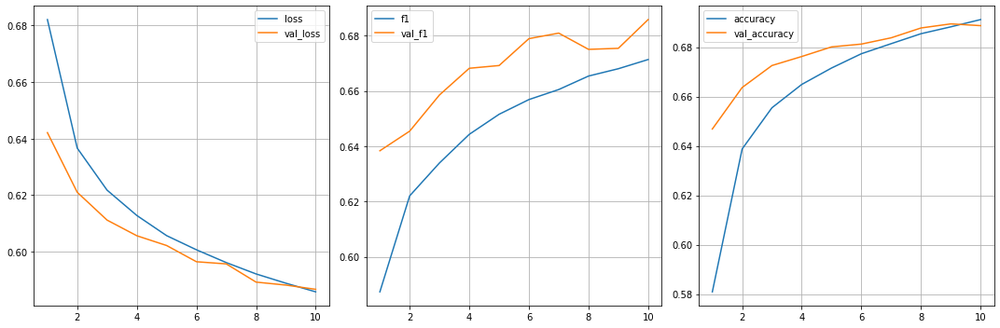

CPU times: user 11min 2s, sys: 52.2 s, total: 11min 54s
Wall time: 22min 42s


In [ ]:
%%time
BATCH_SIZE = 256
EPOCHS = 10
callbacks_list = [PlotLearning()]

history = model.fit(
    rnn_train_data, rnn_train_labels,
    batch_size=BATCH_SIZE,
    epochs=EPOCHS,
    validation_data=(rnn_val_data, rnn_val_labels),
    callbacks=callbacks_list
)

### Testing Model on TestData

In [ ]:
def threshold_scanning(true_labels, predicted_labeles):
    max_f1 = 0
    max_t = 0
    for i in range(10, 80, 1):
        i /= 100
        predicted_f1 = f1_score(true_labels, (predicted_labeles > i))
        if predicted_f1 > max_f1:
            max_f1 = predicted_f1
            max_t = i
    return max_t

In [ ]:
predicted = model.predict(rnn_val_data).reshape(-1)
threshold = threshold_scanning(rnn_val_labels, predicted)
print(f1_score(rnn_val_labels, (predicted > threshold).astype('int')))

0.709676970784142


In [ ]:
%%time
comment_text_df = pd.DataFrame(test_data['comment'])

custom_pipeline = [preprocessing.fillna,
                   preprocessing.lowercase,
                   preprocessing.remove_stopwords,
                   preprocessing.remove_punctuation,
                   preprocessing.remove_digits,
                  ]

comment_text_df['clean_comment'] = hero.clean(comment_text_df['comment'], custom_pipeline)

rnn_test_data = rnn_train_tokenizer.texts_to_sequences(comment_text_df['clean_comment'])
rnn_test_data = pad_sequences(rnn_test_data, maxlen = MAX_LEN)
rnn_test_labels = test_data['label']

predicted = model.predict(rnn_test_data)
print(f1_score(rnn_test_labels, (predicted > threshold).astype('int')))

0.7067674829778431
CPU times: user 37.6 s, sys: 2.51 s, total: 40.1 s
Wall time: 47.8 s


#### Evaluation RNN

In [ ]:
def accuracy(y, y_hat) -> float:
    return accuracy_score(y, y_hat)

def f1(y, y_hat, alpha: float = 0.5, beta: float = 1.):
    return f1_score(y, y_hat)

def precision(y, y_hat) -> float:
    return precision_score(y, y_hat)

def recall(y, y_hat) -> float:
    return recall_score(y, y_hat)

def f1_negative(y, y_hat, alpha: float = 0.5, beta: float = 1.):
    y = 1 - y
    y_hat = 1 - y_hat
    return f1_score(y, y_hat)

def precision_negative(y, y_hat) -> float:
    y = 1 - y
    y_hat = 1 - y_hat
    return precision_score(y, y_hat)

def recall_negative(y, y_hat) -> float:
    y = 1 - y
    y_hat = 1 - y_hat
    return recall_score(y, y_hat)

def roc_auc(y, y_hat) -> float:
    return roc_auc_score(y, y_hat)

def aps(y, y_hat) -> float:
    return average_precision_score(y, y_ha)

evaluation_functions = dict(
    accuracy=accuracy,
    f1=f1,
    precision=precision,
    recall=recall,
    f1_negative=f1_negative,
    precision_negative=precision_negative,
    recall_negative=recall_negative,
    roc_auc=roc_auc,
    average_precision_score=average_precision_score
)

def evaluate(y, y_hat):
    return {name: func(y, y_hat) for name, func in evaluation_functions.items()}


def evluate_rnn_model(model, data_dict, threshold):
    train_eval = evaluate(
        data_dict['train_labels'], model.predict(data_dict['train_data']) > threshold
    )
    val_eval = evaluate(
        data_dict['val_labels'], model.predict(data_dict['val_data']) > threshold
    )

    test_eval = None
    if data_dict['test_labels'] is not None:
        test_eval = evaluate(
            data_dict['test_labels'], model.predict(data_dict['test_data']) > threshold
        )

    return pd.DataFrame(
    {'train':train_eval,
    'validation':val_eval,
    'test':test_eval}
    )


In [ ]:
evluate_rnn_model(model,
        {'train_data':rnn_train_data,
         'train_labels':rnn_train_labels,
         'val_data':rnn_val_data,
         'val_labels':rnn_val_labels,
         'test_data':rnn_test_data,
         'test_labels':rnn_test_labels
        },
        threshold
)

,train,validation,test
accuracy,0.663082,0.655887,0.652376
f1,0.716128,0.709677,0.706767
precision,0.619098,0.613468,0.609938
recall,0.849227,0.841676,0.840142
f1_negative,0.585655,0.577633,0.573212
precision_negative,0.759373,0.748382,0.745455
recall_negative,0.476621,0.470326,0.465626
roc_auc,0.662924,0.656001,0.652884
average_precision_score,0.601205,0.595455,0.592147


# Choosing the final model

In the following, we can see all of the results from our experiments so far:

In [ ]:
pd.DataFrame(
    index = ['tf-idf.LR.only-comments',
             'tf-idf.ADA.only-comments',
             'tf-idf.LR.with-other-features',
             'word2vec.LR.only-comments',
             'word2vec.GNB.only-comments',
             'word2vec.LR.with-other-features',
             'fasttext.LR.only-comments',
             'fasttext.GNB.only-comments',
             'fasttext.LR.with-other-features',
             'rnn.only-comments'
             ],
    data = {
        'f1-train':[0.705386,
                    0.595929,
                    0.708937,
                    0.638376,
                    0.608333,
                    0.667984,
                    0.628623,
                    0.617678,
                    0.656383,
                    0.714354],
        'f1-validation':[0.690493,
                         0.595062,
                         0.697155,
                         0.640614,
                         0.610502,
                         0.662573,
                         0.627470,
                         0.619689,
                         0.651723,
                         0.707104],
        'f1-test':[0.498372,
                   0.401187,
                   None,
                   0.635384,
                   0.607631,
                   None,
                   0.624702,
                   0.618554,
                   None,
                   0.705964]
    }
)


,f1-train,f1-validation,f1-test
tf-idf.LR.only-comments,0.705386,0.690493,0.498372
tf-idf.ADA.only-comments,0.595929,0.595062,0.401187
tf-idf.LR.with-other-features,0.708937,0.697155,NaN
word2vec.LR.only-comments,0.638376,0.640614,0.635384
word2vec.GNB.only-comments,0.608333,0.610502,0.607631
word2vec.LR.with-other-features,0.667984,0.662573,NaN
fasttext.LR.only-comments,0.628623,0.627470,0.624702
fasttext.GNB.only-comments,0.617678,0.619689,0.618554
fasttext.LR.with-other-features,0.656383,0.651723,NaN
rnn.only-comments,0.714354,0.707104,0.705964


<div align='justify'>

We select the **Recurrent Neural Network (RNN)** model as our final choice from the models that we studied in this project. In this RNN, we use Long-Short Term Memory cells called LSTM designed to model sequential sequences and their long-range dependencies more accurately than traditional RNNs. 

Also, we use a bidirectional LSTM layer which consists of a forward and a backward recurrent neural network, and final prediction is made combining the results of both the networks at any given time t. This allows us to use the information from both past and ongoing words in the sentence.

Pros and Cons:

The most important point about using RNNs in language tasks is that they are designed for **sequential data**, and they use their **memory** to predict. On the other hand, they have some disadvantages. LSTMs became successful because they could solve the problem of vanishing gradients. But it turns out they fail to eradicate it. Also, they require **many resources and time** to get trained and become available for real-world uses.
</div>